In [1]:
import numpy as np
import cv2  # OpenCVライブラリ

import matplotlib.pyplot as plt 
%matplotlib inline

import torch

# infer

In [2]:
! ls weights

blazeface128_100.pth   blazeface128VOC_100.pth	blazeface256_10.pth
blazeface128_10.pth    blazeface128VOC_10.pth	blazeface256_110.pth
blazeface128_110.pth   blazeface128VOC_110.pth	blazeface256_120.pth
blazeface128_120.pth   blazeface128VOC_120.pth	blazeface256_130.pth
blazeface128_130.pth   blazeface128VOC_130.pth	blazeface256_140.pth
blazeface128_140.pth   blazeface128VOC_140.pth	blazeface256_150.pth
blazeface128_150.pth   blazeface128VOC_150.pth	blazeface256_160.pth
blazeface128_160.pth   blazeface128VOC_160.pth	blazeface256_170.pth
blazeface128_170.pth   blazeface128VOC_170.pth	blazeface256_180.pth
blazeface128_180.pth   blazeface128VOC_180.pth	blazeface256_190.pth
blazeface128_190.pth   blazeface128VOC_190.pth	blazeface256_200.pth
blazeface128_200.pth   blazeface128VOC_200.pth	blazeface256_20.pth
blazeface128_20.pth    blazeface128VOC_20.pth	blazeface256_30.pth
blazeface128_30.pth    blazeface128VOC_30.pth	blazeface256_40.pth
blazeface128_40.pth    blazeface128VOC_40.pth	blazeface

In [3]:
from utils.blazeface import SSD

voc_classes = ['person']

# SSD300の設定
ssd_cfg = {
    'num_classes': 2,  # 背景クラスを含めた合計クラス数
    'input_size': 128,  # 画像の入力サイズ
    'bbox_aspect_num': [4, 6],  # 出力するDBoxのアスペクト比の種類
    'feature_maps': [16, 8],  # 各sourceの画像サイズ
    'steps': [4, 8],  # DBOXの大きさを決める
    'min_sizes': [30, 60],  # DBOXの大きさを決める
    'max_sizes': [60, 128],  # DBOXの大きさを決める
    'aspect_ratios': [[2], [2, 3], [2, 3], [2, 3], [2], [2]],
}

# SSDネットワークモデル
net = SSD(phase="inference", cfg=ssd_cfg)

# SSDの学習済みの重みを設定
net_weights = torch.load('./weights/blazeface128_200.pth',
                         map_location={'cuda:0': 'cpu'})

net.load_state_dict(net_weights)

print('loaded the trained weights')


BlazeFace(
  (features): Sequential(
    (0): Conv2d(3, 24, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(24, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace)
    (3): BlazeBlock(
      (conv1): Sequential(
        (0): Conv2d(24, 24, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2), groups=24)
        (1): BatchNorm2d(24, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): Conv2d(24, 24, kernel_size=(1, 1), stride=(1, 1))
        (3): BatchNorm2d(24, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (act): ReLU(inplace)
    )
    (4): BlazeBlock(
      (conv1): Sequential(
        (0): Conv2d(24, 24, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2), groups=24)
        (1): BatchNorm2d(24, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): Conv2d(24, 24, kernel_size=(1, 1), stride=(1, 1))
        (3): BatchNorm2d(24, eps=1e-05, momentum=0.1, a

In [4]:
!ls sample

img2.png  img.png  sample.jpg


In [5]:
import cv2
image_file_path = "./sample/sample.jpg"
img = cv2.imread(image_file_path)  # [高さ][幅][色BGR]
img.shape

(183, 275, 3)

./sample/sample.jpg


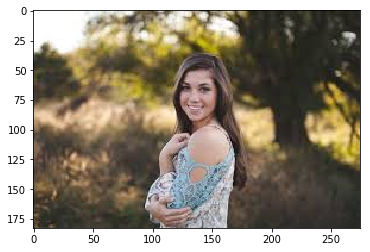

loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([1406])
torch.Size([1, 2, 200, 5])
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([1406])


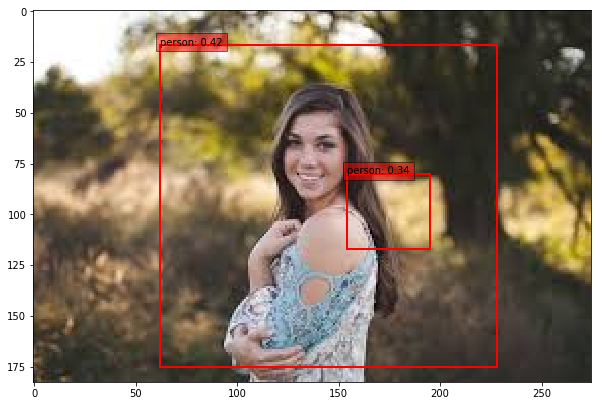

In [6]:
from utils.ssd_model import DataTransform
import glob
# 画像に対する予測
from utils.ssd_predict_show import SSDPredictShow
# 1. 画像読み込み
image_file_path = "./sample/sample.jpg"

ssd = SSDPredictShow(eval_categories=voc_classes, net=net)

for imp in glob.glob(image_file_path):
    print(imp)
    img = cv2.imread(imp)  # [高さ][幅][色BGR]
    height, width, channels = img.shape  # 画像のサイズを取得

    # 2. 元画像の表示
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.show()

    # 3. 前処理クラスの作成
    color_mean = (104, 117, 123)  # (BGR)の色の平均値
    input_size = 128  # 画像のinputサイズを300×300にする
    transform = DataTransform(input_size, color_mean)

    # 4. 前処理
    phase = "val"
    img_transformed, boxes, labels = transform(img, phase, "", "")  # アノテーションはないので、""にする
    img = torch.from_numpy(img_transformed[:, :, (2, 1, 0)]).permute(2, 0, 1)

    # 5. SSDで予測
    net.eval()  # ネットワークを推論モードへ
    x = img.unsqueeze(0)  # ミニバッチ化：torch.Size([1, 3, 300, 300])
    detections = net(x)

    print(detections.shape)
    #print(detections)

    # output : torch.Size([batch_num, 21, 200, 5])
    #  =（batch_num、クラス、confのtop200、規格化されたBBoxの情報）
    #   規格化されたBBoxの情報（確信度、xmin, ymin, xmax, ymax）
    
    ssd.show(imp, data_confidence_level=0.3)



../VOCdevkit/VOC2007/JPEGImages/005629.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([1408])


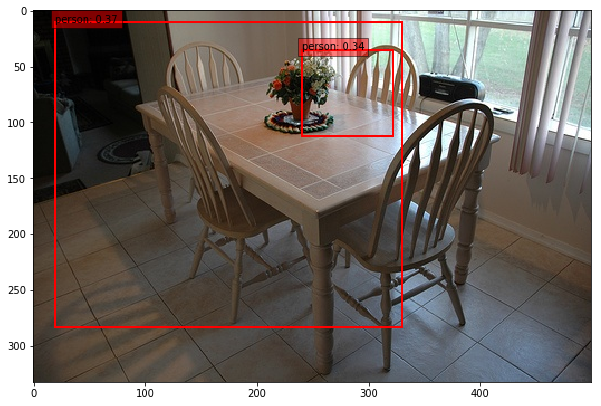

../VOCdevkit/VOC2007/JPEGImages/006519.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([1407])


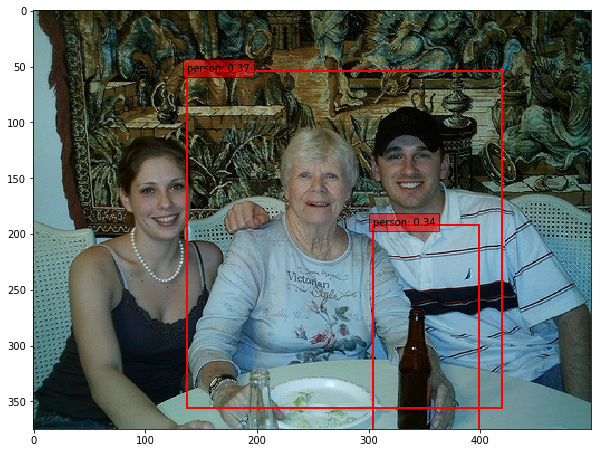

../VOCdevkit/VOC2007/JPEGImages/003017.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([1404])


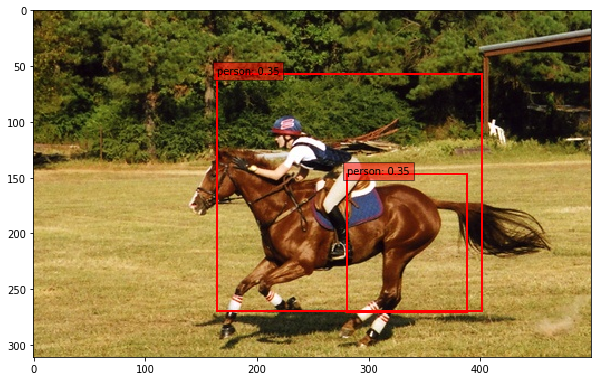

../VOCdevkit/VOC2007/JPEGImages/007454.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([1404])


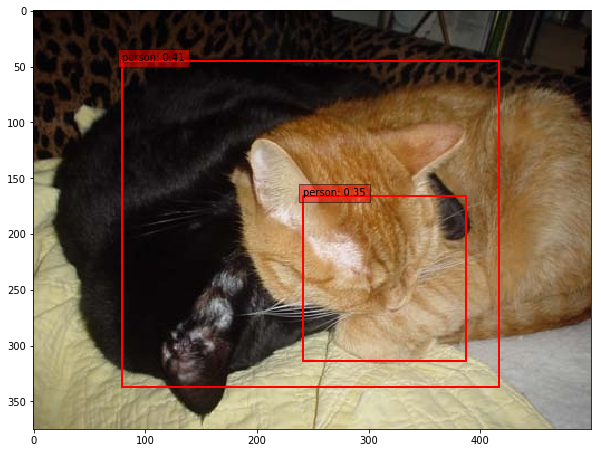

../VOCdevkit/VOC2007/JPEGImages/007074.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([1402])


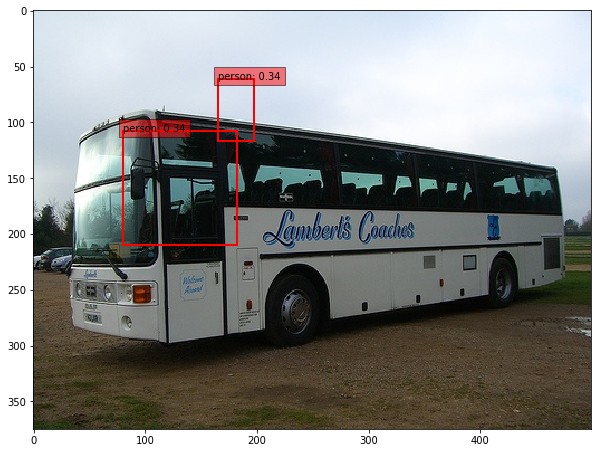

../VOCdevkit/VOC2007/JPEGImages/000680.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([1404])


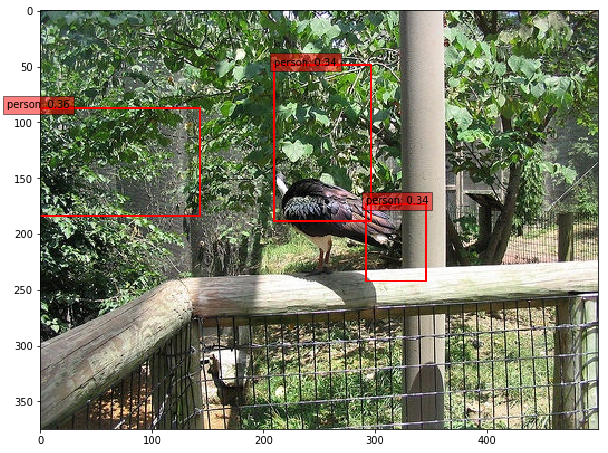

../VOCdevkit/VOC2007/JPEGImages/000460.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([1404])


KeyboardInterrupt: 

In [7]:
from utils.ssd_model import DataTransform
import glob
# 画像に対する予測
from utils.ssd_predict_show import SSDPredictShow
# 1. 画像読み込み
image_file_path = "../VOCdevkit/VOC2007/JPEGImages/*"

ssd = SSDPredictShow(eval_categories=voc_classes, net=net)

for imp in glob.glob(image_file_path)[:50]:
    print(imp)
    img = cv2.imread(imp)  # [高さ][幅][色BGR]
    height, width, channels = img.shape  # 画像のサイズを取得

    # 2. 元画像の表示
    #plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    #plt.show()
    
    ssd.show(imp, data_confidence_level=0.3)
    plt.show()


In [8]:
! ls weights

blazeface128_100.pth   blazeface128VOC_100.pth	blazeface256_10.pth
blazeface128_10.pth    blazeface128VOC_10.pth	blazeface256_110.pth
blazeface128_110.pth   blazeface128VOC_110.pth	blazeface256_120.pth
blazeface128_120.pth   blazeface128VOC_120.pth	blazeface256_130.pth
blazeface128_130.pth   blazeface128VOC_130.pth	blazeface256_140.pth
blazeface128_140.pth   blazeface128VOC_140.pth	blazeface256_150.pth
blazeface128_150.pth   blazeface128VOC_150.pth	blazeface256_160.pth
blazeface128_160.pth   blazeface128VOC_160.pth	blazeface256_170.pth
blazeface128_170.pth   blazeface128VOC_170.pth	blazeface256_180.pth
blazeface128_180.pth   blazeface128VOC_180.pth	blazeface256_190.pth
blazeface128_190.pth   blazeface128VOC_190.pth	blazeface256_200.pth
blazeface128_200.pth   blazeface128VOC_200.pth	blazeface256_20.pth
blazeface128_20.pth    blazeface128VOC_20.pth	blazeface256_30.pth
blazeface128_30.pth    blazeface128VOC_30.pth	blazeface256_40.pth
blazeface128_40.pth    blazeface128VOC_40.pth	blazeface

In [9]:
from utils.blazeface import SSD

voc_classes = ['aeroplane', 'bicycle', 'bird', 'boat',
               'bottle', 'bus', 'car', 'cat', 'chair',
               'cow', 'diningtable', 'dog', 'horse',
               'motorbike', 'person', 'pottedplant',
               'sheep', 'sofa', 'train', 'tvmonitor']

# SSD300の設定
ssd_cfg = {
    'num_classes': 21,  # 背景クラスを含めた合計クラス数
    'input_size': 128,  # 画像の入力サイズ
    'bbox_aspect_num': [4, 6],  # 出力するDBoxのアスペクト比の種類
    'feature_maps': [16, 8],  # 各sourceの画像サイズ
    'steps': [4, 8],  # DBOXの大きさを決める
    'min_sizes': [30, 60],  # DBOXの大きさを決める
    'max_sizes': [60, 128],  # DBOXの大きさを決める
    'aspect_ratios': [[2], [2, 3], [2, 3], [2, 3], [2], [2]],
}

# SSDネットワークモデル
net = SSD(phase="inference", cfg=ssd_cfg)

# SSDの学習済みの重みを設定
net_weights = torch.load('./weights/blazeface128VOC_200.pth',
                         map_location={'cuda:0': 'cpu'})

net.load_state_dict(net_weights)

print('loaded the trained weights')


loaded the trained weights


../VOCdevkit/VOC2007/JPEGImages/005629.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([170])
torch.Size([70])
torch.Size([897])
torch.Size([249])
torch.Size([357])
torch.Size([66])
torch.Size([1101])
torch.Size([445])
torch.Size([1132])
torch.Size([204])
torch.Size([48])
torch.Size([632])
torch.Size([168])
torch.Size([149])
torch.Size([1396])
torch.Size([1002])
torch.Size([135])
torch.Size([179])
torch.Size([151])
torch.Size([984])


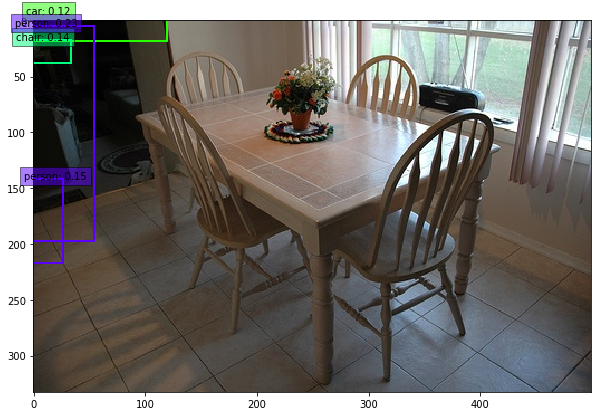

../VOCdevkit/VOC2007/JPEGImages/006519.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([76])
torch.Size([107])
torch.Size([683])
torch.Size([176])
torch.Size([306])
torch.Size([47])
torch.Size([1052])
torch.Size([237])
torch.Size([1132])
torch.Size([153])
torch.Size([38])
torch.Size([429])
torch.Size([166])
torch.Size([275])
torch.Size([1398])
torch.Size([1037])
torch.Size([109])
torch.Size([145])
torch.Size([200])
torch.Size([911])


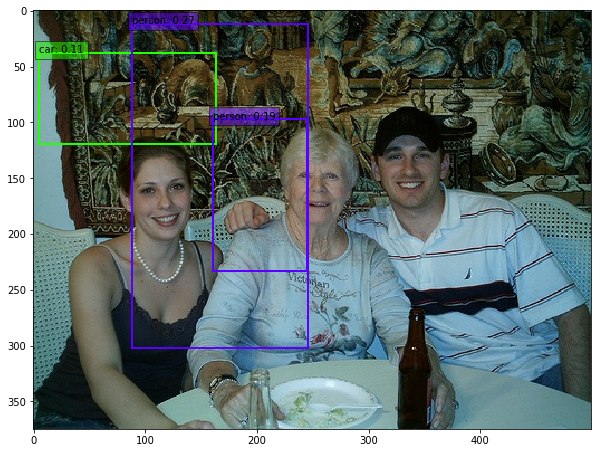

../VOCdevkit/VOC2007/JPEGImages/003017.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([161])
torch.Size([95])
torch.Size([849])
torch.Size([276])
torch.Size([320])
torch.Size([59])
torch.Size([1167])
torch.Size([283])
torch.Size([1132])
torch.Size([240])
torch.Size([47])
torch.Size([526])
torch.Size([161])
torch.Size([220])
torch.Size([1400])
torch.Size([1015])
torch.Size([130])
torch.Size([151])
torch.Size([231])
torch.Size([931])


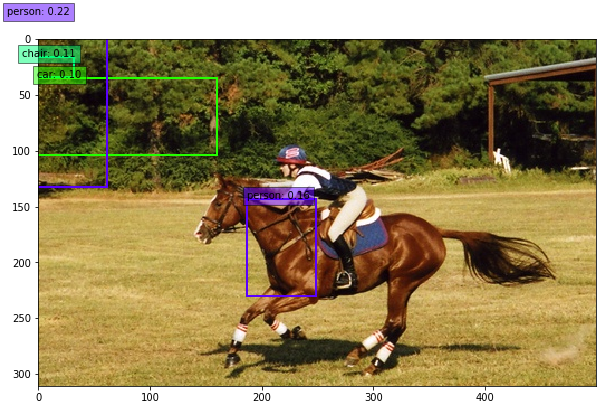

../VOCdevkit/VOC2007/JPEGImages/007454.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([180])
torch.Size([37])
torch.Size([746])
torch.Size([201])
torch.Size([357])
torch.Size([50])
torch.Size([915])
torch.Size([559])
torch.Size([1199])
torch.Size([153])
torch.Size([34])
torch.Size([617])
torch.Size([96])
torch.Size([101])
torch.Size([1398])
torch.Size([972])
torch.Size([202])
torch.Size([199])
torch.Size([111])
torch.Size([953])


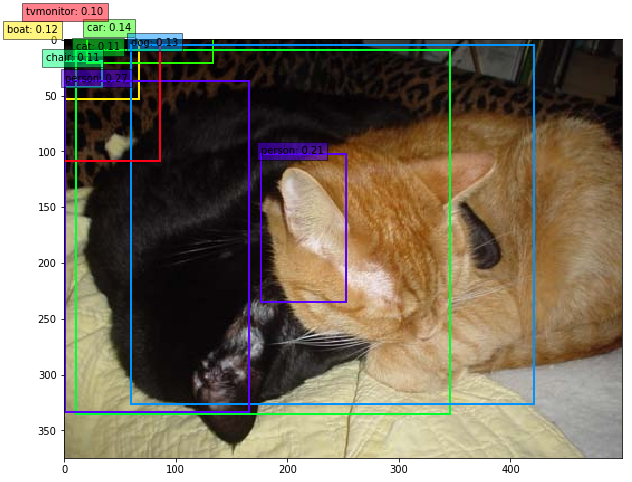

../VOCdevkit/VOC2007/JPEGImages/007074.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([431])
torch.Size([46])
torch.Size([613])
torch.Size([714])
torch.Size([179])
torch.Size([201])
torch.Size([1190])
torch.Size([155])
torch.Size([803])
torch.Size([131])
torch.Size([33])
torch.Size([281])
torch.Size([74])
torch.Size([141])
torch.Size([1350])
torch.Size([745])
torch.Size([154])
torch.Size([65])
torch.Size([330])
torch.Size([840])


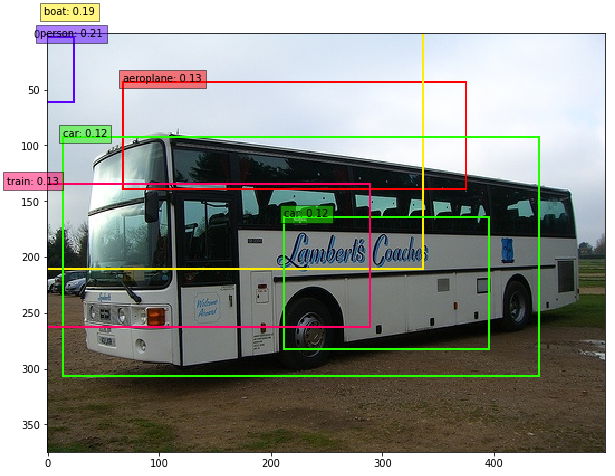

../VOCdevkit/VOC2007/JPEGImages/000680.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([50])
torch.Size([160])
torch.Size([643])
torch.Size([232])
torch.Size([233])
torch.Size([64])
torch.Size([1113])
torch.Size([74])
torch.Size([996])
torch.Size([197])
torch.Size([36])
torch.Size([192])
torch.Size([199])
torch.Size([338])
torch.Size([1394])
torch.Size([1062])
torch.Size([69])
torch.Size([73])
torch.Size([264])
torch.Size([881])


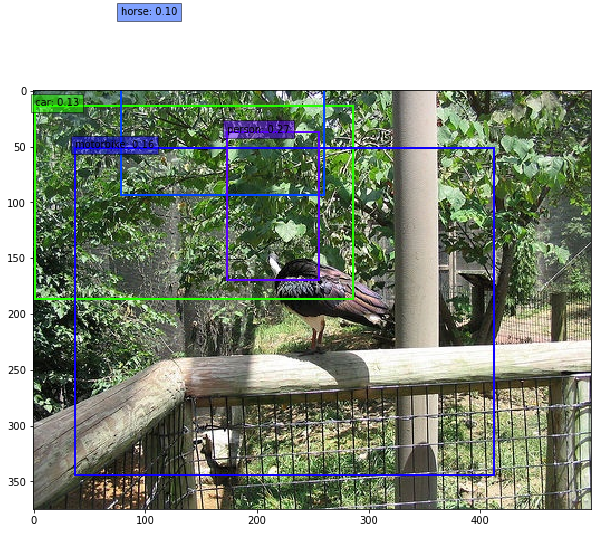

../VOCdevkit/VOC2007/JPEGImages/000460.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([467])
torch.Size([104])
torch.Size([1026])
torch.Size([527])
torch.Size([305])
torch.Size([91])
torch.Size([1094])
torch.Size([536])
torch.Size([1048])
torch.Size([276])
torch.Size([32])
torch.Size([783])
torch.Size([105])
torch.Size([97])
torch.Size([1381])
torch.Size([838])
torch.Size([235])
torch.Size([179])
torch.Size([103])
torch.Size([828])


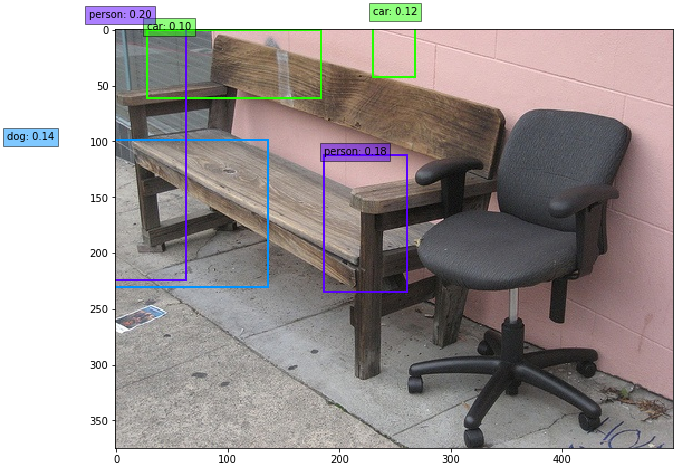

../VOCdevkit/VOC2007/JPEGImages/004622.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([264])
torch.Size([78])
torch.Size([761])
torch.Size([395])
torch.Size([267])
torch.Size([57])
torch.Size([1112])
torch.Size([288])
torch.Size([1005])
torch.Size([186])
torch.Size([38])
torch.Size([489])
torch.Size([100])
torch.Size([154])
torch.Size([1385])
torch.Size([927])
torch.Size([146])
torch.Size([130])
torch.Size([154])
torch.Size([874])


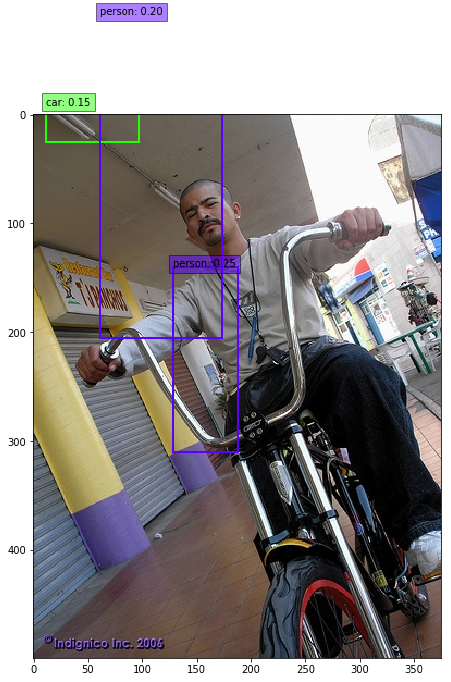

../VOCdevkit/VOC2007/JPEGImages/001281.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([333])
torch.Size([125])
torch.Size([996])
torch.Size([422])
torch.Size([295])
torch.Size([89])
torch.Size([1149])
torch.Size([512])
torch.Size([1146])
torch.Size([270])
torch.Size([61])
torch.Size([763])
torch.Size([191])
torch.Size([198])
torch.Size([1396])
torch.Size([853])
torch.Size([191])
torch.Size([264])
torch.Size([174])
torch.Size([797])


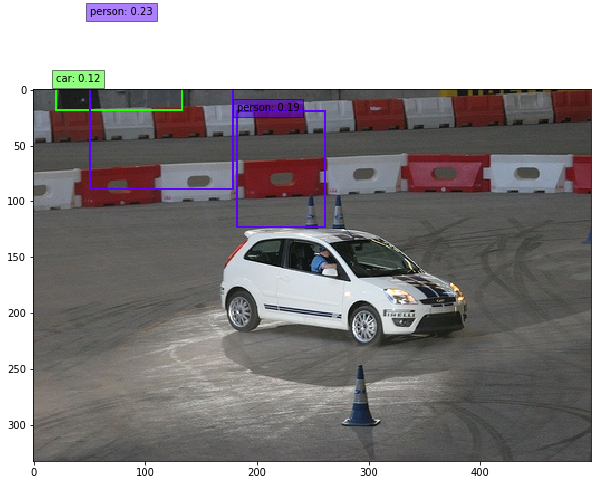

../VOCdevkit/VOC2007/JPEGImages/005497.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([720])
torch.Size([23])
torch.Size([888])
torch.Size([754])
torch.Size([364])
torch.Size([45])
torch.Size([1240])
torch.Size([539])
torch.Size([1237])
torch.Size([202])
torch.Size([44])
torch.Size([786])
torch.Size([45])
torch.Size([54])
torch.Size([1399])
torch.Size([916])
torch.Size([511])
torch.Size([271])
torch.Size([124])
torch.Size([1101])


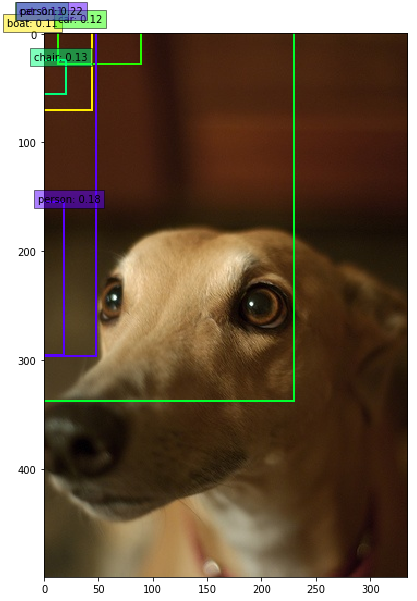

../VOCdevkit/VOC2007/JPEGImages/000042.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([158])
torch.Size([107])
torch.Size([825])
torch.Size([443])
torch.Size([269])
torch.Size([167])
torch.Size([1194])
torch.Size([211])
torch.Size([1035])
torch.Size([230])
torch.Size([31])
torch.Size([386])
torch.Size([173])
torch.Size([231])
torch.Size([1402])
torch.Size([975])
torch.Size([94])
torch.Size([128])
torch.Size([314])
torch.Size([1009])


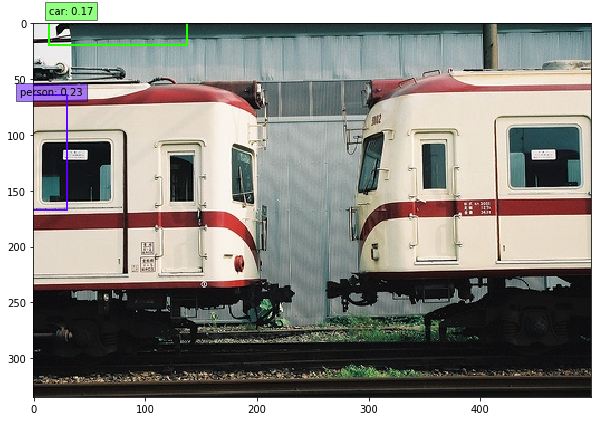

../VOCdevkit/VOC2007/JPEGImages/003077.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([246])
torch.Size([57])
torch.Size([836])
torch.Size([388])
torch.Size([343])
torch.Size([67])
torch.Size([1003])
torch.Size([355])
torch.Size([1091])
torch.Size([193])
torch.Size([33])
torch.Size([573])
torch.Size([139])
torch.Size([144])
torch.Size([1401])
torch.Size([977])
torch.Size([138])
torch.Size([146])
torch.Size([129])
torch.Size([966])


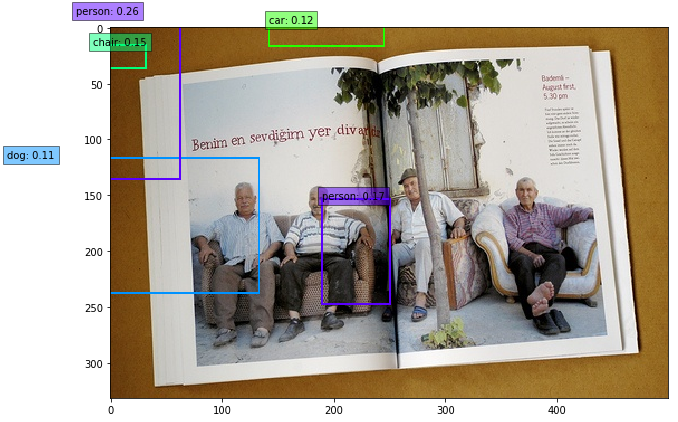

../VOCdevkit/VOC2007/JPEGImages/005637.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([60])
torch.Size([188])
torch.Size([792])
torch.Size([185])
torch.Size([302])
torch.Size([77])
torch.Size([1143])
torch.Size([252])
torch.Size([1105])
torch.Size([254])
torch.Size([45])
torch.Size([467])
torch.Size([285])
torch.Size([359])
torch.Size([1396])
torch.Size([1020])
torch.Size([81])
torch.Size([162])
torch.Size([235])
torch.Size([804])


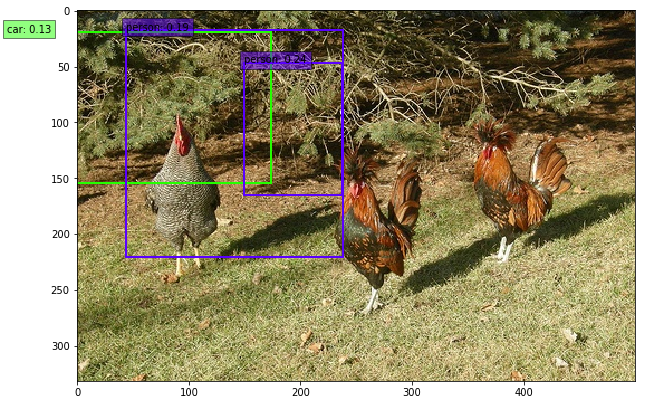

../VOCdevkit/VOC2007/JPEGImages/001498.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([143])
torch.Size([25])
torch.Size([583])
torch.Size([142])
torch.Size([416])
torch.Size([18])
torch.Size([923])
torch.Size([482])
torch.Size([1211])
torch.Size([86])
torch.Size([44])
torch.Size([527])
torch.Size([45])
torch.Size([58])
torch.Size([1395])
torch.Size([996])
torch.Size([235])
torch.Size([188])
torch.Size([84])
torch.Size([1079])


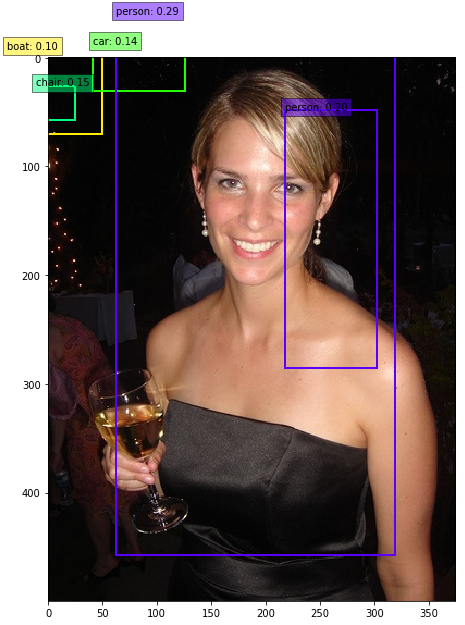

../VOCdevkit/VOC2007/JPEGImages/004939.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([143])
torch.Size([87])
torch.Size([847])
torch.Size([298])
torch.Size([296])
torch.Size([68])
torch.Size([1096])
torch.Size([428])
torch.Size([1068])
torch.Size([193])
torch.Size([40])
torch.Size([599])
torch.Size([146])
torch.Size([116])
torch.Size([1383])
torch.Size([975])
torch.Size([109])
torch.Size([131])
torch.Size([114])
torch.Size([867])


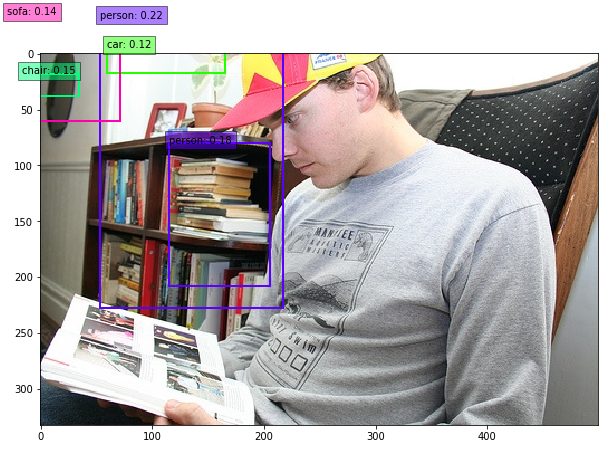

../VOCdevkit/VOC2007/JPEGImages/008749.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([22])
torch.Size([121])
torch.Size([338])
torch.Size([156])
torch.Size([209])
torch.Size([73])
torch.Size([1142])
torch.Size([52])
torch.Size([968])
torch.Size([98])
torch.Size([33])
torch.Size([88])
torch.Size([149])
torch.Size([375])
torch.Size([1400])
torch.Size([1114])
torch.Size([71])
torch.Size([72])
torch.Size([297])
torch.Size([970])


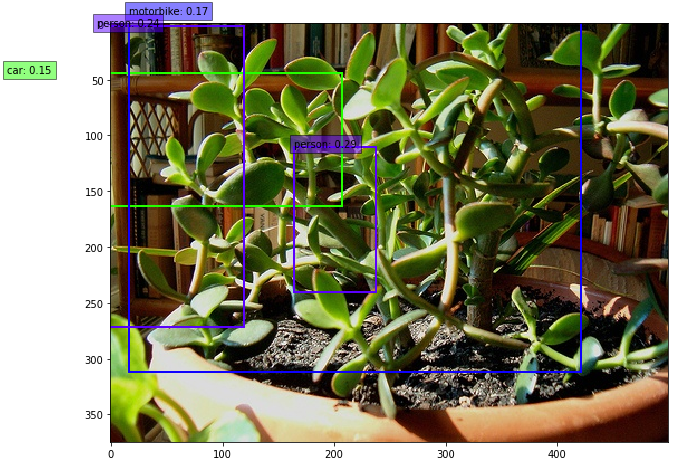

../VOCdevkit/VOC2007/JPEGImages/001143.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([115])
torch.Size([122])
torch.Size([888])
torch.Size([296])
torch.Size([321])
torch.Size([65])
torch.Size([1150])
torch.Size([294])
torch.Size([1105])
torch.Size([231])
torch.Size([45])
torch.Size([529])
torch.Size([192])
torch.Size([224])
torch.Size([1394])
torch.Size([1021])
torch.Size([112])
torch.Size([157])
torch.Size([223])
torch.Size([925])


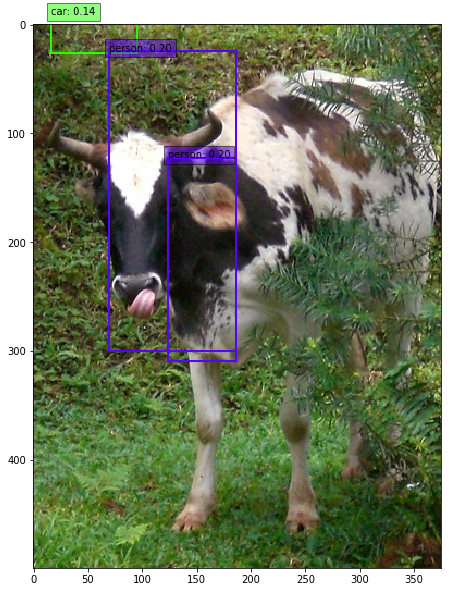

../VOCdevkit/VOC2007/JPEGImages/005885.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([514])
torch.Size([37])
torch.Size([848])
torch.Size([752])
torch.Size([277])
torch.Size([107])
torch.Size([1208])
torch.Size([279])
torch.Size([961])
torch.Size([207])
torch.Size([37])
torch.Size([499])
torch.Size([78])
torch.Size([72])
torch.Size([1359])
torch.Size([849])
torch.Size([254])
torch.Size([126])
torch.Size([250])
torch.Size([963])


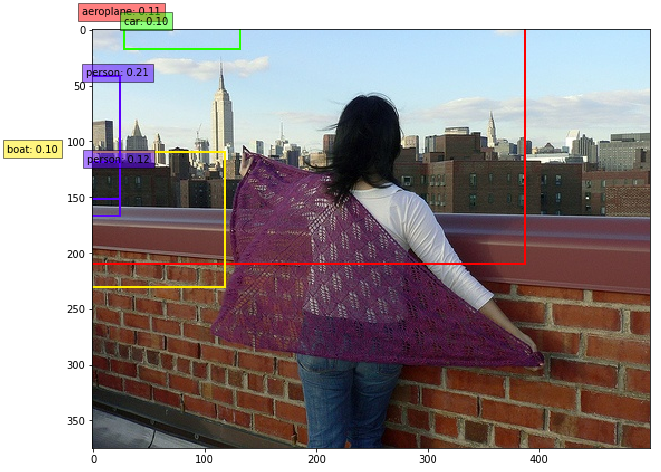

../VOCdevkit/VOC2007/JPEGImages/002114.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([685])
torch.Size([120])
torch.Size([845])
torch.Size([674])
torch.Size([238])
torch.Size([91])
torch.Size([1085])
torch.Size([458])
torch.Size([825])
torch.Size([171])
torch.Size([39])
torch.Size([670])
torch.Size([66])
torch.Size([106])
torch.Size([1346])
torch.Size([569])
torch.Size([204])
torch.Size([199])
torch.Size([125])
torch.Size([493])


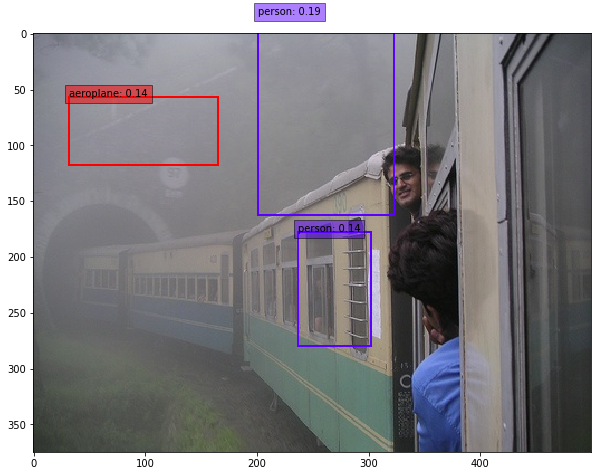

../VOCdevkit/VOC2007/JPEGImages/009200.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([548])
torch.Size([79])
torch.Size([991])
torch.Size([691])
torch.Size([301])
torch.Size([113])
torch.Size([1143])
torch.Size([426])
torch.Size([1049])
torch.Size([216])
torch.Size([54])
torch.Size([721])
torch.Size([119])
torch.Size([136])
torch.Size([1389])
torch.Size([840])
torch.Size([278])
torch.Size([217])
torch.Size([205])
torch.Size([831])


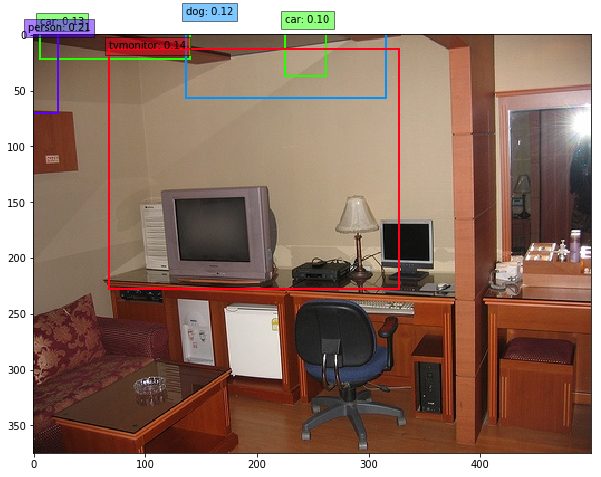

../VOCdevkit/VOC2007/JPEGImages/005815.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([160])
torch.Size([56])
torch.Size([880])
torch.Size([367])
torch.Size([338])
torch.Size([110])
torch.Size([1191])
torch.Size([387])
torch.Size([1093])
torch.Size([223])
torch.Size([43])
torch.Size([528])
torch.Size([156])
torch.Size([148])
torch.Size([1392])
torch.Size([1039])
torch.Size([171])
torch.Size([162])
torch.Size([231])
torch.Size([1040])


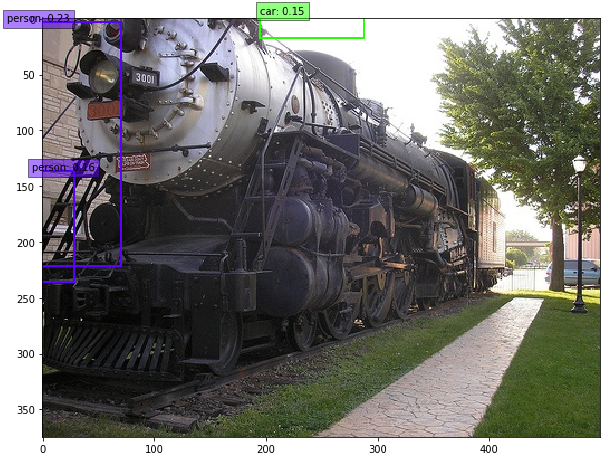

../VOCdevkit/VOC2007/JPEGImages/004322.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([161])
torch.Size([23])
torch.Size([460])
torch.Size([184])
torch.Size([365])
torch.Size([47])
torch.Size([1049])
torch.Size([369])
torch.Size([1198])
torch.Size([69])
torch.Size([51])
torch.Size([383])
torch.Size([56])
torch.Size([74])
torch.Size([1397])
torch.Size([1026])
torch.Size([236])
torch.Size([165])
torch.Size([131])
torch.Size([1123])


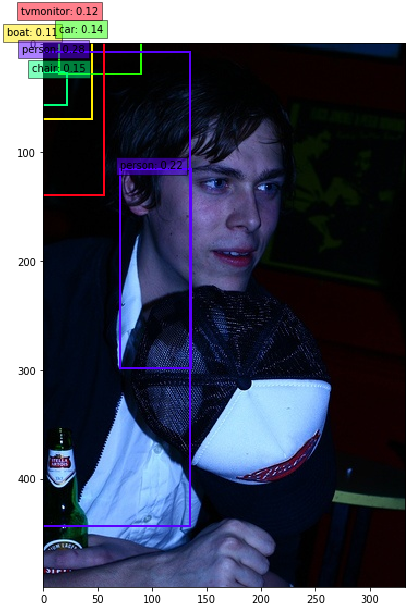

../VOCdevkit/VOC2007/JPEGImages/004792.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([514])
torch.Size([197])
torch.Size([1007])
torch.Size([571])
torch.Size([237])
torch.Size([167])
torch.Size([1175])
torch.Size([567])
torch.Size([1070])
torch.Size([314])
torch.Size([58])
torch.Size([864])
torch.Size([181])
torch.Size([228])
torch.Size([1393])
torch.Size([701])
torch.Size([170])
torch.Size([250])
torch.Size([191])
torch.Size([603])


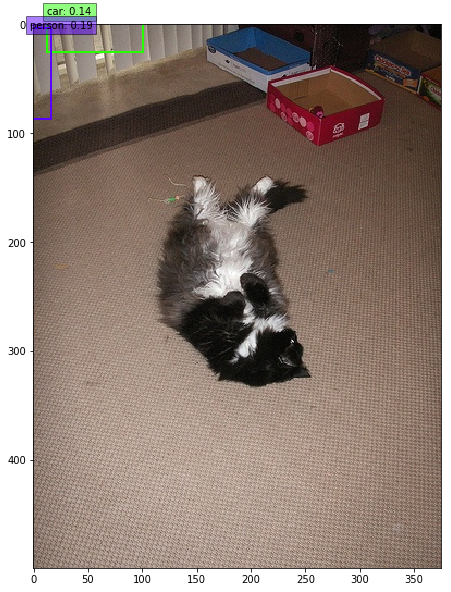

../VOCdevkit/VOC2007/JPEGImages/001457.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([315])
torch.Size([51])
torch.Size([879])
torch.Size([392])
torch.Size([334])
torch.Size([69])
torch.Size([1069])
torch.Size([487])
torch.Size([1094])
torch.Size([181])
torch.Size([44])
torch.Size([695])
torch.Size([118])
torch.Size([82])
torch.Size([1388])
torch.Size([921])
torch.Size([232])
torch.Size([211])
torch.Size([138])
torch.Size([936])


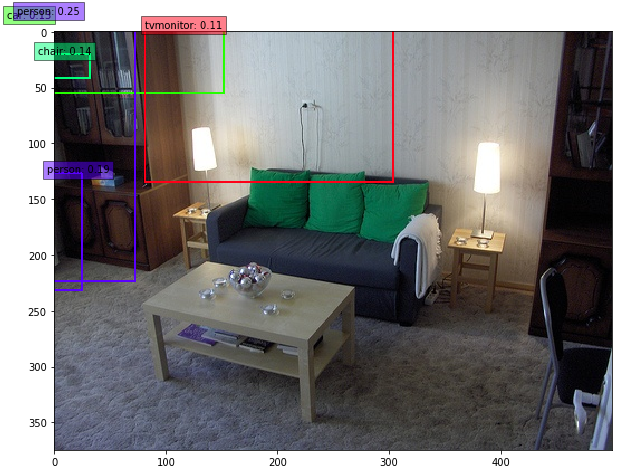

../VOCdevkit/VOC2007/JPEGImages/000519.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([870])
torch.Size([115])
torch.Size([882])
torch.Size([903])
torch.Size([139])
torch.Size([260])
torch.Size([1173])
torch.Size([338])
torch.Size([744])
torch.Size([240])
torch.Size([24])
torch.Size([733])
torch.Size([60])
torch.Size([128])
torch.Size([1329])
torch.Size([423])
torch.Size([143])
torch.Size([125])
torch.Size([277])
torch.Size([409])


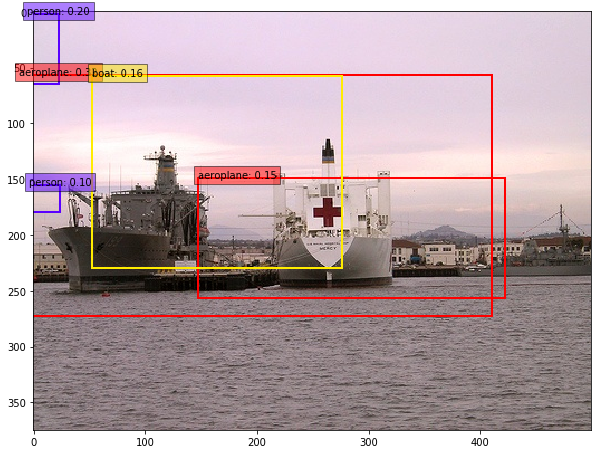

../VOCdevkit/VOC2007/JPEGImages/006462.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([306])
torch.Size([99])
torch.Size([1020])
torch.Size([394])
torch.Size([319])
torch.Size([44])
torch.Size([1036])
torch.Size([494])
torch.Size([1107])
torch.Size([305])
torch.Size([38])
torch.Size([749])
torch.Size([115])
torch.Size([101])
torch.Size([1389])
torch.Size([846])
torch.Size([211])
torch.Size([222])
torch.Size([92])
torch.Size([770])


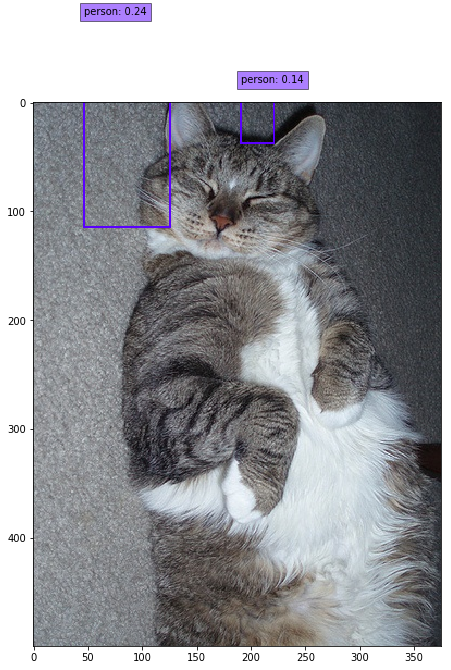

../VOCdevkit/VOC2007/JPEGImages/007311.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([194])
torch.Size([104])
torch.Size([1024])
torch.Size([342])
torch.Size([333])
torch.Size([99])
torch.Size([1112])
torch.Size([470])
torch.Size([1137])
torch.Size([303])
torch.Size([41])
torch.Size([712])
torch.Size([165])
torch.Size([161])
torch.Size([1398])
torch.Size([993])
torch.Size([164])
torch.Size([236])
torch.Size([181])
torch.Size([923])


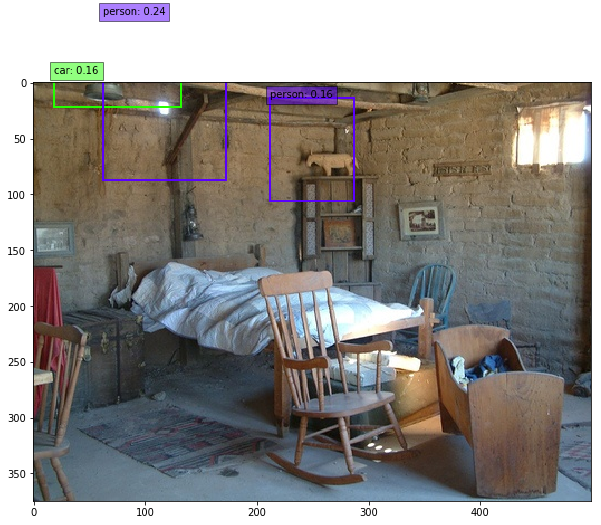

../VOCdevkit/VOC2007/JPEGImages/001184.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([403])
torch.Size([149])
torch.Size([856])
torch.Size([418])
torch.Size([267])
torch.Size([107])
torch.Size([1057])
torch.Size([558])
torch.Size([1009])
torch.Size([210])
torch.Size([39])
torch.Size([756])
torch.Size([175])
torch.Size([147])
torch.Size([1378])
torch.Size([792])
torch.Size([107])
torch.Size([150])
torch.Size([74])
torch.Size([648])


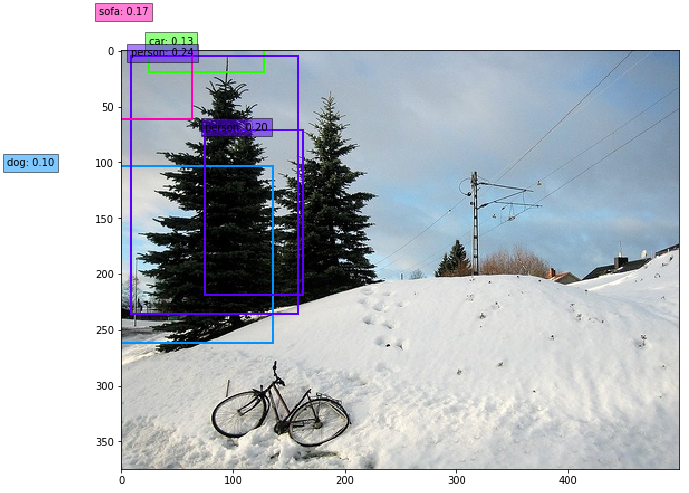

../VOCdevkit/VOC2007/JPEGImages/005414.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([40])
torch.Size([107])
torch.Size([523])
torch.Size([136])
torch.Size([292])
torch.Size([30])
torch.Size([932])
torch.Size([169])
torch.Size([1009])
torch.Size([124])
torch.Size([35])
torch.Size([301])
torch.Size([153])
torch.Size([240])
torch.Size([1398])
torch.Size([1030])
torch.Size([61])
torch.Size([99])
torch.Size([85])
torch.Size([801])


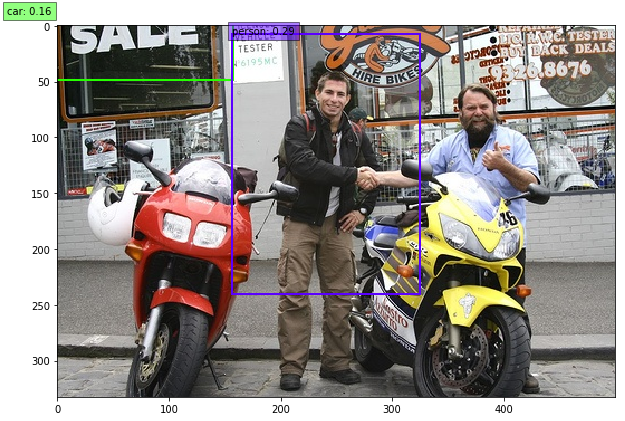

../VOCdevkit/VOC2007/JPEGImages/007878.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([145])
torch.Size([61])
torch.Size([910])
torch.Size([193])
torch.Size([428])
torch.Size([28])
torch.Size([918])
torch.Size([586])
torch.Size([1177])
torch.Size([200])
torch.Size([54])
torch.Size([717])
torch.Size([108])
torch.Size([73])
torch.Size([1394])
torch.Size([1009])
torch.Size([234])
torch.Size([230])
torch.Size([81])
torch.Size([976])


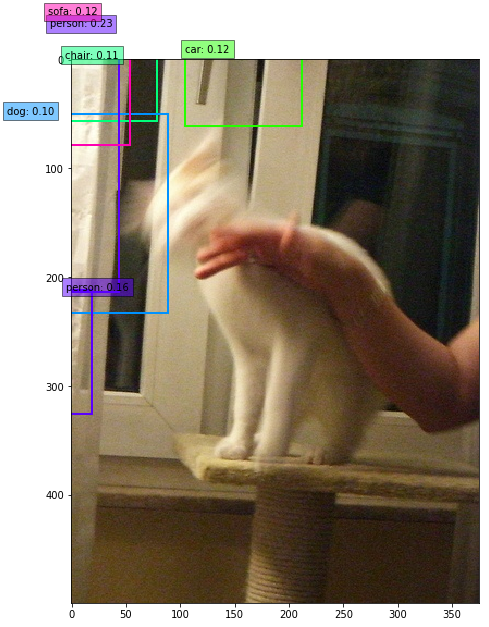

../VOCdevkit/VOC2007/JPEGImages/007833.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([1029])
torch.Size([109])
torch.Size([960])
torch.Size([945])
torch.Size([142])
torch.Size([147])
torch.Size([1177])
torch.Size([524])
torch.Size([775])
torch.Size([207])
torch.Size([37])
torch.Size([898])
torch.Size([55])
torch.Size([127])
torch.Size([1342])
torch.Size([401])
torch.Size([187])
torch.Size([168])
torch.Size([126])
torch.Size([380])


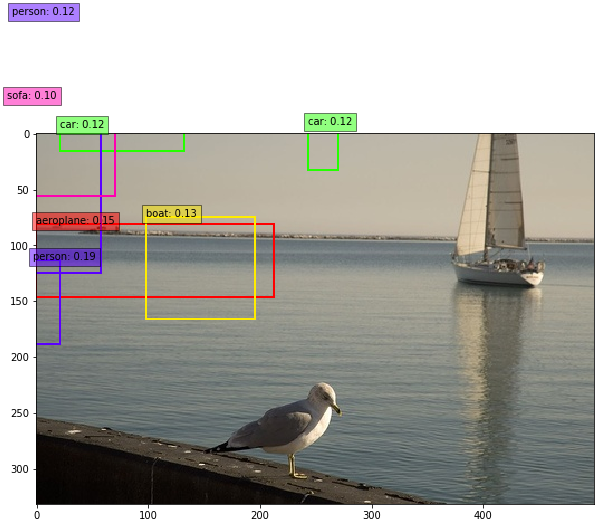

../VOCdevkit/VOC2007/JPEGImages/007149.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([79])
torch.Size([50])
torch.Size([592])
torch.Size([146])
torch.Size([424])
torch.Size([18])
torch.Size([841])
torch.Size([434])
torch.Size([1157])
torch.Size([125])
torch.Size([39])
torch.Size([495])
torch.Size([87])
torch.Size([100])
torch.Size([1397])
torch.Size([1026])
torch.Size([133])
torch.Size([143])
torch.Size([59])
torch.Size([968])


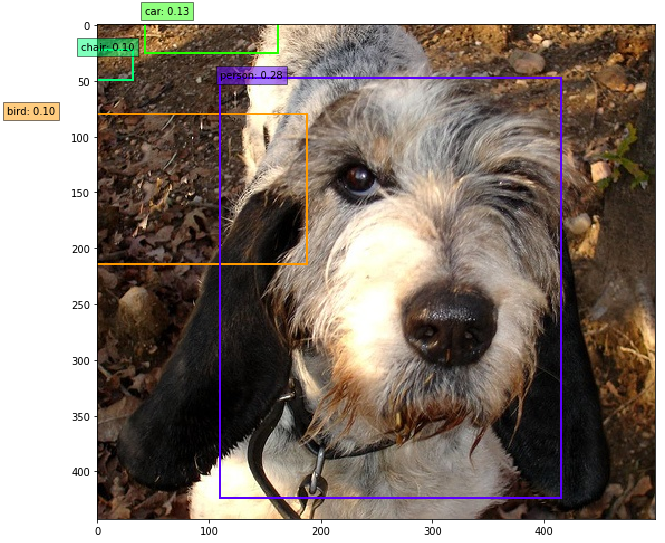

../VOCdevkit/VOC2007/JPEGImages/005259.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([108])
torch.Size([43])
torch.Size([536])
torch.Size([321])
torch.Size([300])
torch.Size([150])
torch.Size([1240])
torch.Size([157])
torch.Size([1130])
torch.Size([109])
torch.Size([35])
torch.Size([253])
torch.Size([77])
torch.Size([239])
torch.Size([1398])
torch.Size([1067])
torch.Size([108])
torch.Size([132])
torch.Size([357])
torch.Size([1129])


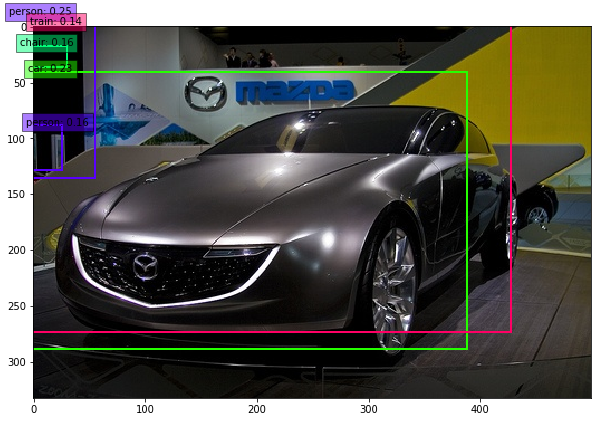

../VOCdevkit/VOC2007/JPEGImages/005861.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([913])
torch.Size([110])
torch.Size([804])
torch.Size([937])
torch.Size([133])
torch.Size([247])
torch.Size([1191])
torch.Size([249])
torch.Size([652])
torch.Size([196])
torch.Size([29])
torch.Size([607])
torch.Size([48])
torch.Size([105])
torch.Size([1315])
torch.Size([405])
torch.Size([150])
torch.Size([83])
torch.Size([188])
torch.Size([431])


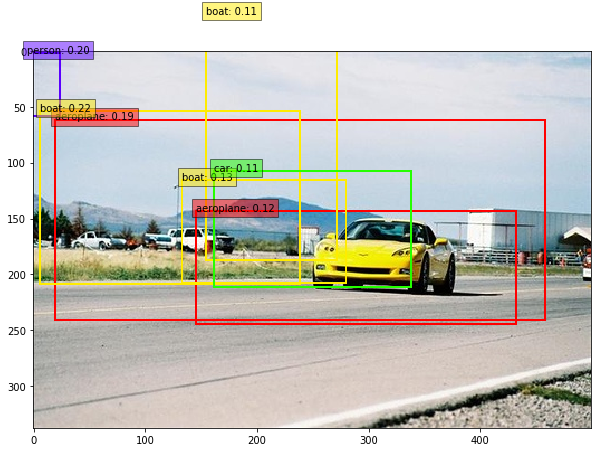

../VOCdevkit/VOC2007/JPEGImages/008747.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([436])
torch.Size([175])
torch.Size([912])
torch.Size([720])
torch.Size([203])
torch.Size([273])
torch.Size([1241])
torch.Size([301])
torch.Size([957])
torch.Size([274])
torch.Size([29])
torch.Size([582])
torch.Size([181])
torch.Size([216])
torch.Size([1387])
torch.Size([718])
torch.Size([124])
torch.Size([137])
torch.Size([307])
torch.Size([704])


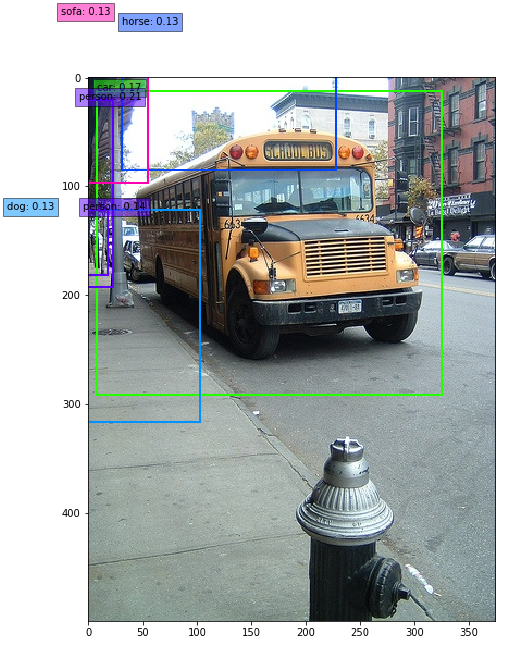

../VOCdevkit/VOC2007/JPEGImages/007672.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([891])
torch.Size([91])
torch.Size([1005])
torch.Size([901])
torch.Size([255])
torch.Size([141])
torch.Size([1157])
torch.Size([600])
torch.Size([980])
torch.Size([254])
torch.Size([43])
torch.Size([889])
torch.Size([90])
torch.Size([110])
torch.Size([1392])
torch.Size([687])
torch.Size([236])
torch.Size([288])
torch.Size([125])
torch.Size([793])


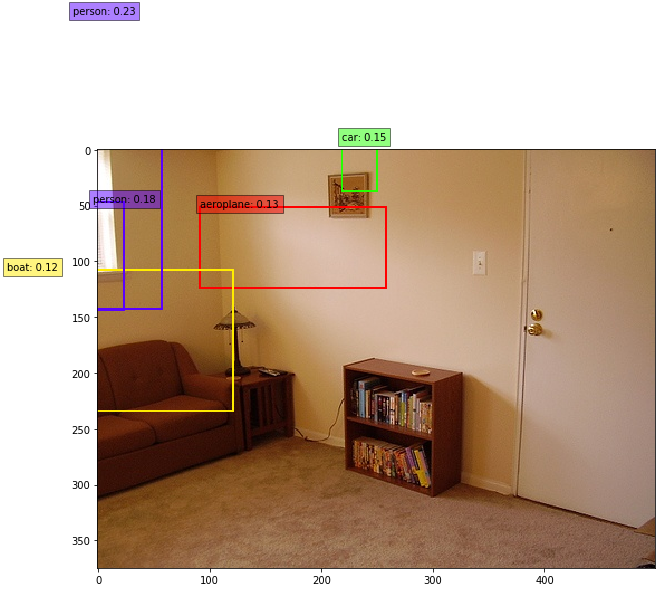

../VOCdevkit/VOC2007/JPEGImages/000039.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([682])
torch.Size([78])
torch.Size([1046])
torch.Size([783])
torch.Size([305])
torch.Size([65])
torch.Size([1100])
torch.Size([560])
torch.Size([1075])
torch.Size([286])
torch.Size([28])
torch.Size([868])
torch.Size([74])
torch.Size([83])
torch.Size([1386])
torch.Size([750])
torch.Size([233])
torch.Size([213])
torch.Size([80])
torch.Size([775])


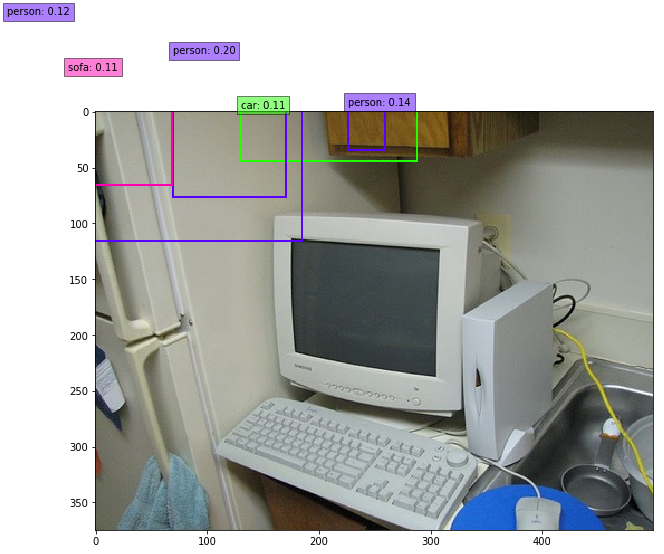

../VOCdevkit/VOC2007/JPEGImages/008269.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([155])
torch.Size([45])
torch.Size([801])
torch.Size([205])
torch.Size([402])
torch.Size([34])
torch.Size([936])
torch.Size([572])
torch.Size([1205])
torch.Size([172])
torch.Size([55])
torch.Size([669])
torch.Size([113])
torch.Size([105])
torch.Size([1399])
torch.Size([963])
torch.Size([223])
torch.Size([213])
torch.Size([77])
torch.Size([964])


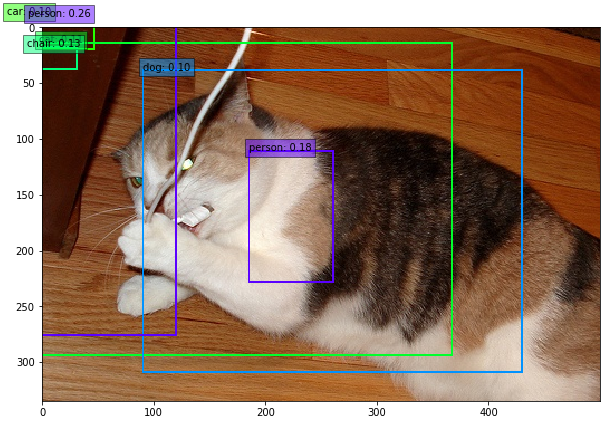

../VOCdevkit/VOC2007/JPEGImages/009537.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([381])
torch.Size([104])
torch.Size([807])
torch.Size([683])
torch.Size([232])
torch.Size([172])
torch.Size([1230])
torch.Size([230])
torch.Size([927])
torch.Size([197])
torch.Size([25])
torch.Size([414])
torch.Size([115])
torch.Size([126])
torch.Size([1370])
torch.Size([861])
torch.Size([226])
torch.Size([96])
torch.Size([318])
torch.Size([890])


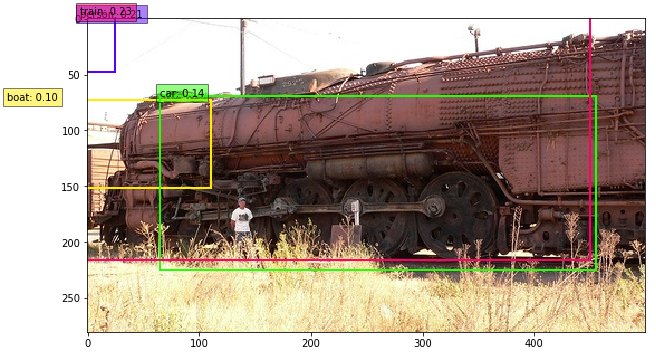

../VOCdevkit/VOC2007/JPEGImages/002281.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([107])
torch.Size([85])
torch.Size([439])
torch.Size([321])
torch.Size([234])
torch.Size([226])
torch.Size([1235])
torch.Size([121])
torch.Size([1006])
torch.Size([129])
torch.Size([24])
torch.Size([178])
torch.Size([112])
torch.Size([249])
torch.Size([1395])
torch.Size([953])
torch.Size([93])
torch.Size([110])
torch.Size([426])
torch.Size([1010])


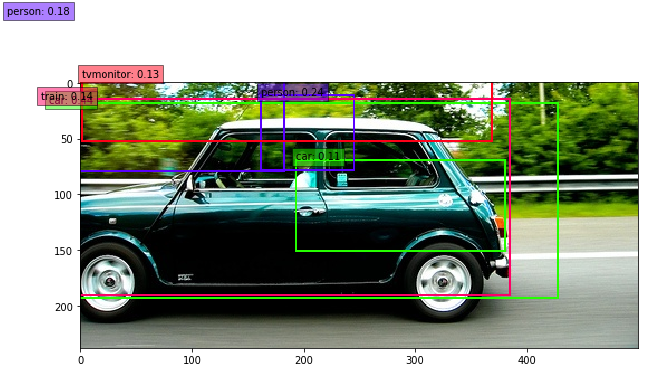

../VOCdevkit/VOC2007/JPEGImages/003436.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([227])
torch.Size([66])
torch.Size([696])
torch.Size([467])
torch.Size([243])
torch.Size([51])
torch.Size([1067])
torch.Size([230])
torch.Size([891])
torch.Size([137])
torch.Size([31])
torch.Size([375])
torch.Size([97])
torch.Size([93])
torch.Size([1365])
torch.Size([853])
torch.Size([131])
torch.Size([81])
torch.Size([175])
torch.Size([804])


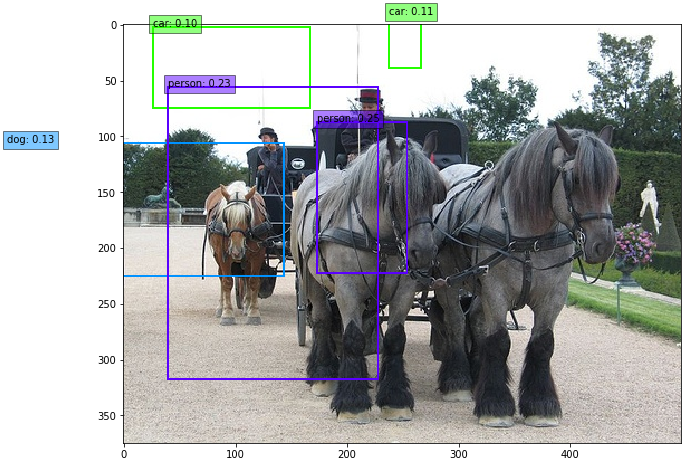

../VOCdevkit/VOC2007/JPEGImages/009523.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([739])
torch.Size([99])
torch.Size([971])
torch.Size([709])
torch.Size([216])
torch.Size([64])
torch.Size([1063])
torch.Size([451])
torch.Size([851])
torch.Size([177])
torch.Size([30])
torch.Size([833])
torch.Size([59])
torch.Size([88])
torch.Size([1354])
torch.Size([552])
torch.Size([135])
torch.Size([118])
torch.Size([43])
torch.Size([517])


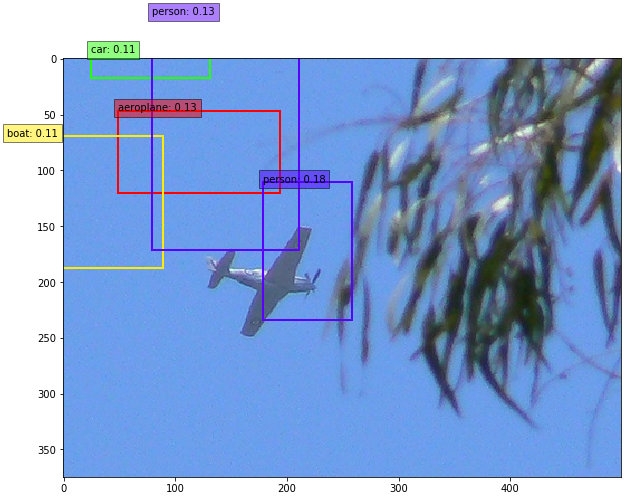

../VOCdevkit/VOC2007/JPEGImages/006981.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([172])
torch.Size([147])
torch.Size([961])
torch.Size([263])
torch.Size([310])
torch.Size([66])
torch.Size([1064])
torch.Size([499])
torch.Size([1051])
torch.Size([267])
torch.Size([47])
torch.Size([699])
torch.Size([199])
torch.Size([166])
torch.Size([1388])
torch.Size([889])
torch.Size([82])
torch.Size([170])
torch.Size([112])
torch.Size([740])


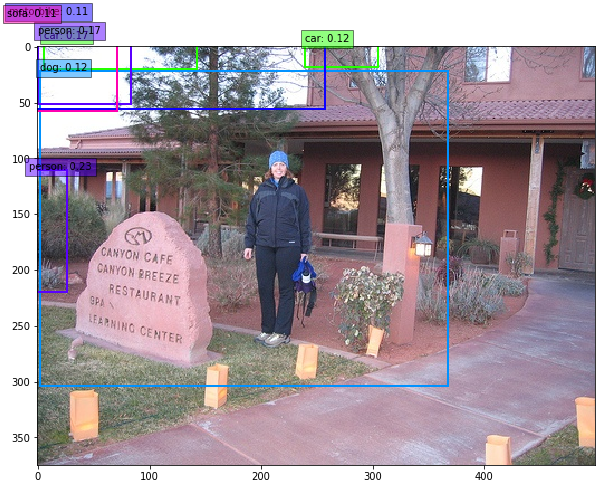

../VOCdevkit/VOC2007/JPEGImages/007772.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([509])
torch.Size([63])
torch.Size([973])
torch.Size([436])
torch.Size([358])
torch.Size([36])
torch.Size([1058])
torch.Size([632])
torch.Size([1175])
torch.Size([191])
torch.Size([43])
torch.Size([846])
torch.Size([77])
torch.Size([89])
torch.Size([1392])
torch.Size([847])
torch.Size([389])
torch.Size([291])
torch.Size([105])
torch.Size([857])


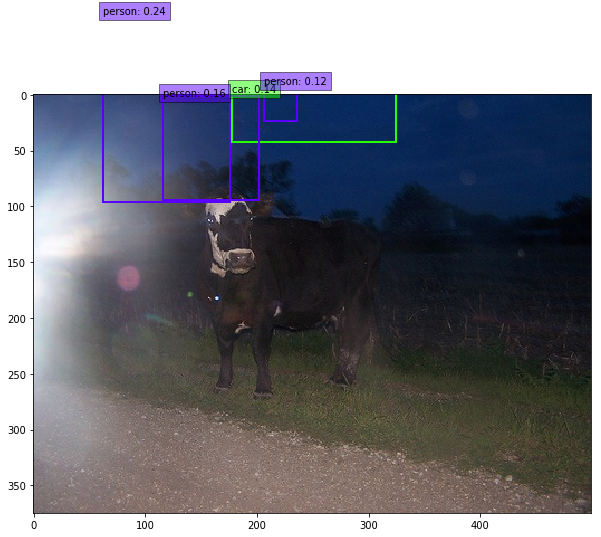

../VOCdevkit/VOC2007/JPEGImages/004438.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([232])
torch.Size([58])
torch.Size([790])
torch.Size([297])
torch.Size([390])
torch.Size([34])
torch.Size([908])
torch.Size([520])
torch.Size([1136])
torch.Size([175])
torch.Size([41])
torch.Size([609])
torch.Size([85])
torch.Size([53])
torch.Size([1388])
torch.Size([939])
torch.Size([226])
torch.Size([184])
torch.Size([51])
torch.Size([945])


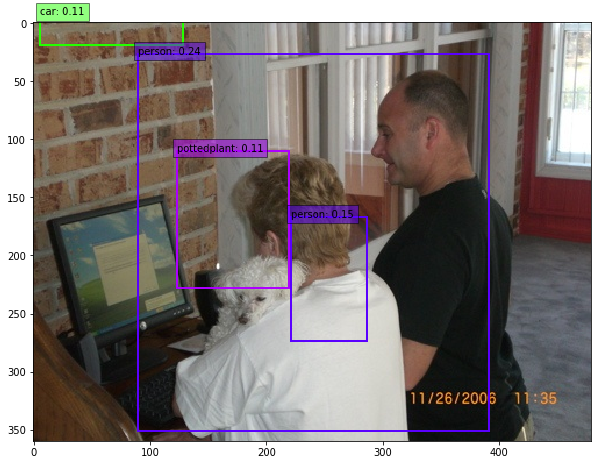

../VOCdevkit/VOC2007/JPEGImages/000777.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([232])
torch.Size([60])
torch.Size([751])
torch.Size([278])
torch.Size([339])
torch.Size([38])
torch.Size([1006])
torch.Size([464])
torch.Size([1173])
torch.Size([185])
torch.Size([47])
torch.Size([590])
torch.Size([133])
torch.Size([135])
torch.Size([1397])
torch.Size([927])
torch.Size([151])
torch.Size([200])
torch.Size([94])
torch.Size([918])


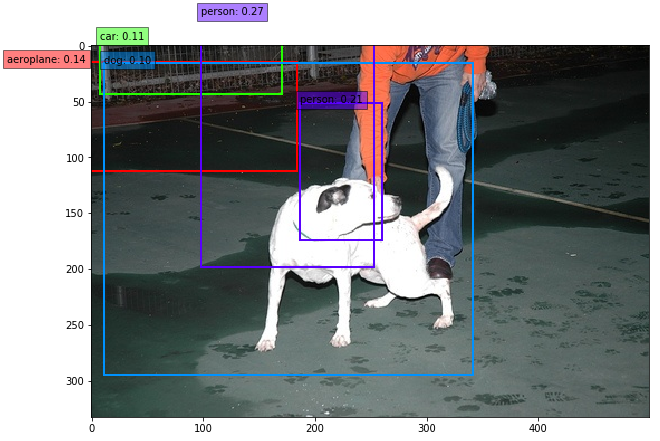

../VOCdevkit/VOC2007/JPEGImages/003575.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([90])
torch.Size([99])
torch.Size([668])
torch.Size([203])
torch.Size([332])
torch.Size([66])
torch.Size([1172])
torch.Size([188])
torch.Size([1141])
torch.Size([167])
torch.Size([43])
torch.Size([367])
torch.Size([156])
torch.Size([279])
torch.Size([1398])
torch.Size([1090])
torch.Size([157])
torch.Size([165])
torch.Size([245])
torch.Size([1024])


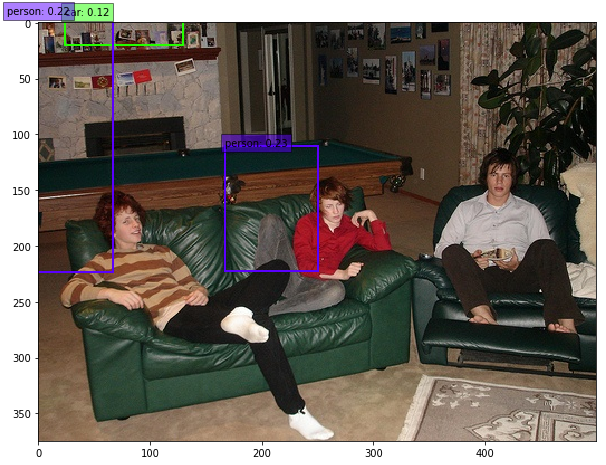

../VOCdevkit/VOC2007/JPEGImages/006868.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([449])
torch.Size([97])
torch.Size([848])
torch.Size([684])
torch.Size([243])
torch.Size([169])
torch.Size([1235])
torch.Size([263])
torch.Size([944])
torch.Size([189])
torch.Size([38])
torch.Size([462])
torch.Size([96])
torch.Size([187])
torch.Size([1389])
torch.Size([856])
torch.Size([145])
torch.Size([100])
torch.Size([292])
torch.Size([890])


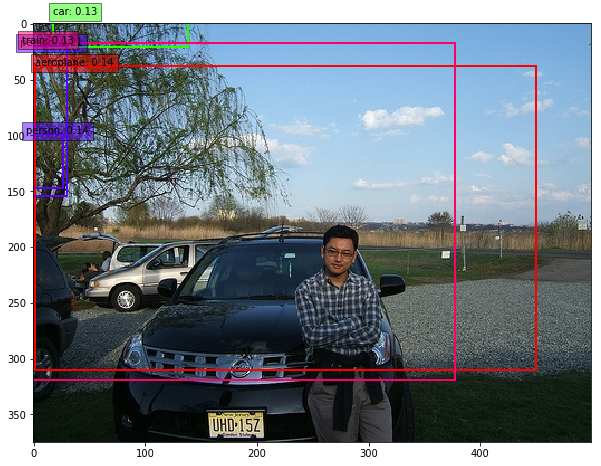

../VOCdevkit/VOC2007/JPEGImages/000526.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([160])
torch.Size([43])
torch.Size([374])
torch.Size([175])
torch.Size([348])
torch.Size([27])
torch.Size([1088])
torch.Size([248])
torch.Size([1161])
torch.Size([65])
torch.Size([37])
torch.Size([303])
torch.Size([64])
torch.Size([138])
torch.Size([1397])
torch.Size([1061])
torch.Size([194])
torch.Size([143])
torch.Size([130])
torch.Size([1128])


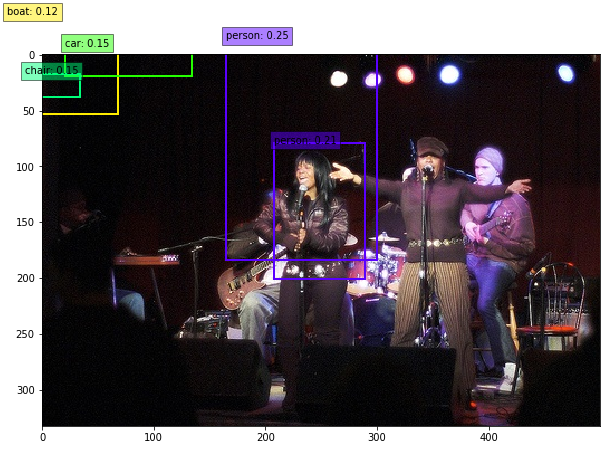

../VOCdevkit/VOC2007/JPEGImages/007372.jpg
loc torch.Size([1, 1408, 4])
box torch.Size([1408, 4])
torch.Size([981])
torch.Size([98])
torch.Size([1061])
torch.Size([1037])
torch.Size([178])
torch.Size([261])
torch.Size([1251])
torch.Size([399])
torch.Size([932])
torch.Size([346])
torch.Size([31])
torch.Size([867])
torch.Size([83])
torch.Size([114])
torch.Size([1369])
torch.Size([537])
torch.Size([171])
torch.Size([179])
torch.Size([229])
torch.Size([566])


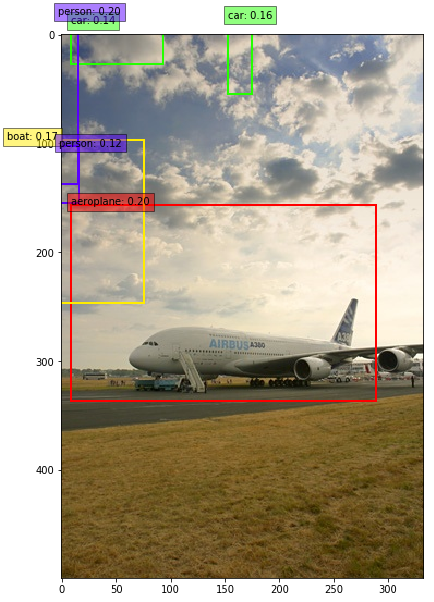

In [11]:
from utils.ssd_model import DataTransform
import glob
# 画像に対する予測
from utils.ssd_predict_show import SSDPredictShow
# 1. 画像読み込み
image_file_path = "../VOCdevkit/VOC2007/JPEGImages/*"

ssd = SSDPredictShow(eval_categories=voc_classes, net=net)

for imp in glob.glob(image_file_path)[:50]:
    print(imp)
    img = cv2.imread(imp)  # [高さ][幅][色BGR]
    height, width, channels = img.shape  # 画像のサイズを取得

    # 2. 元画像の表示
    #plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    #plt.show()
    
    ssd.show(imp, data_confidence_level=0.1)
    plt.show()
